In [5]:
# Create Similarity Indices for all the movies

In [1]:
import pandas as pd
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

In [2]:
# https://en.wikipedia.org/wiki/Jensen%E2%80%93Shannon_divergence
# 
df_original=pd.read_csv("dataset/movie_metadata.csv")
df=pd.read_csv('dataset/preprocessed_dataset.csv')

In [3]:
df_original.head()

,color,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,...,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
0,Color,James Cameron,723.0,178.0,0.0,855.0,Joel David Moore,1000.0,760505847.0,Action|Adventure|Fantasy|Sci-Fi,...,3054.0,English,USA,PG-13,237000000.0,2009.0,936.0,7.9,1.78,33000
1,Color,Gore Verbinski,302.0,169.0,563.0,1000.0,Orlando Bloom,40000.0,309404152.0,Action|Adventure|Fantasy,...,1238.0,English,USA,PG-13,300000000.0,2007.0,5000.0,7.1,2.35,0
2,Color,Sam Mendes,602.0,148.0,0.0,161.0,Rory Kinnear,11000.0,200074175.0,Action|Adventure|Thriller,...,994.0,English,UK,PG-13,245000000.0,2015.0,393.0,6.8,2.35,85000
3,Color,Christopher Nolan,813.0,164.0,22000.0,23000.0,Christian Bale,27000.0,448130642.0,Action|Thriller,...,2701.0,English,USA,PG-13,250000000.0,2012.0,23000.0,8.5,2.35,164000
4,NaN,Doug Walker,NaN,NaN,131.0,NaN,Rob Walker,131.0,NaN,Documentary,...,NaN,NaN,NaN,NaN,NaN,NaN,12.0,7.1,NaN,0


In [18]:
df_original

,color,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,...,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
0,Color,James Cameron,723.0,178.0,0.0,855.0,Joel David Moore,1000.0,760505847.0,Action|Adventure|Fantasy|Sci-Fi,...,3054.0,English,USA,PG-13,237000000.0,2009.0,936.0,7.9,1.78,33000
1,Color,Gore Verbinski,302.0,169.0,563.0,1000.0,Orlando Bloom,40000.0,309404152.0,Action|Adventure|Fantasy,...,1238.0,English,USA,PG-13,300000000.0,2007.0,5000.0,7.1,2.35,0
2,Color,Sam Mendes,602.0,148.0,0.0,161.0,Rory Kinnear,11000.0,200074175.0,Action|Adventure|Thriller,...,994.0,English,UK,PG-13,245000000.0,2015.0,393.0,6.8,2.35,85000
3,Color,Christopher Nolan,813.0,164.0,22000.0,23000.0,Christian Bale,27000.0,448130642.0,Action|Thriller,...,2701.0,English,USA,PG-13,250000000.0,2012.0,23000.0,8.5,2.35,164000
4,NaN,Doug Walker,NaN,NaN,131.0,NaN,Rob Walker,131.0,NaN,Documentary,...,NaN,NaN,NaN,NaN,NaN,NaN,12.0,7.1,NaN,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5038,Color,Scott Smith,1.0,87.0,2.0,318.0,Daphne Zuniga,637.0,NaN,Comedy|Drama,...,6.0,English,Canada,NaN,NaN,2013.0,470.0,7.7,NaN,84
5039,Color,NaN,43.0,43.0,NaN,319.0,Valorie Curry,841.0,NaN,Crime|Drama|Mystery|Thriller,...,359.0,English,USA,TV-14,NaN,NaN,593.0,7.5,16.00,32000
5040,Color,Benjamin Roberds,13.0,76.0,0.0,0.0,Maxwell Moody,0.0,NaN,Drama|Horror|Thriller,...,3.0,English,USA,NaN,1400.0,2013.0,0.0,6.3,NaN,16
5041,Color,Daniel Hsia,14.0,100.0,0.0,489.0,Daniel Henney,946.0,10443.0,Comedy|Drama|Romance,...,9.0,English,USA,PG-13,NaN,2012.0,719.0,6.3,2.35,660


In [16]:
# similarity for the first value
df_original_1 = df_original.iloc[0]

In [55]:
# Avatar Data
avatar_index = 0
copy_df_1 = df_original
df_original_name_1 = copy_df_1.iloc[0]['movie_title'].lower().replace("\xa0", "")

In [56]:
first_half_1 = copy_df_1[0:avatar_index]
other_half_1 = copy_df_1[avatar_index+1:]

In [58]:
copy_df_1 = pd.concat([first_half_1, other_half_1])

In [59]:
copy_df_1['reference_title'] = df_original_name_1
copy_df_1['similar'] = 0

In [62]:
"""
SOURCE : https://bestsimilar.com/movies/8812-avatar
1. John Carter, 
2. Valerian and the City of a Thousand Planets (2017), 
3. Guardians of the Galaxy Vol. 2 (2017), 
4. Oblivion (2013), 
5. Guardians of the Galaxy (2014), 
6. Ender's Game (2013),   
7. Stargate (1994)
8. After Earth (2013),
9. Divergent (2014),
10. Edge of Tomorrow (2014),
11. The Fifth Element (1997),
12. Pacific Rim (2013),
13. Warcraft (2016),
14. The Great Wall (2016),
15. Ready Player One (2018),
16. Dune (1984),
17. Jurassic World (2015),
18. Avatar 2 (2022),
19. Rogue One: A Star Wars Story (2016),
20. Jupiter Ascending (2015),
21. Alita: Battle Angel (2019)
"""
copy_df_1['similar'][0] = 1

,color,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,...,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,reference_title,similar
1,Color,Gore Verbinski,302.0,169.0,563.0,1000.0,Orlando Bloom,40000.0,309404152.0,Action|Adventure|Fantasy,...,USA,PG-13,300000000.0,2007.0,5000.0,7.1,2.35,0,avatar,0
2,Color,Sam Mendes,602.0,148.0,0.0,161.0,Rory Kinnear,11000.0,200074175.0,Action|Adventure|Thriller,...,UK,PG-13,245000000.0,2015.0,393.0,6.8,2.35,85000,avatar,0
3,Color,Christopher Nolan,813.0,164.0,22000.0,23000.0,Christian Bale,27000.0,448130642.0,Action|Thriller,...,USA,PG-13,250000000.0,2012.0,23000.0,8.5,2.35,164000,avatar,0
4,NaN,Doug Walker,NaN,NaN,131.0,NaN,Rob Walker,131.0,NaN,Documentary,...,NaN,NaN,NaN,NaN,12.0,7.1,NaN,0,avatar,0
5,Color,Andrew Stanton,462.0,132.0,475.0,530.0,Samantha Morton,640.0,73058679.0,Action|Adventure|Sci-Fi,...,USA,PG-13,263700000.0,2012.0,632.0,6.6,2.35,24000,avatar,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5038,Color,Scott Smith,1.0,87.0,2.0,318.0,Daphne Zuniga,637.0,NaN,Comedy|Drama,...,Canada,NaN,NaN,2013.0,470.0,7.7,NaN,84,avatar,0
5039,Color,NaN,43.0,43.0,NaN,319.0,Valorie Curry,841.0,NaN,Crime|Drama|Mystery|Thriller,...,USA,TV-14,NaN,NaN,593.0,7.5,16.00,32000,avatar,0
5040,Color,Benjamin Roberds,13.0,76.0,0.0,0.0,Maxwell Moody,0.0,NaN,Drama|Horror|Thriller,...,USA,NaN,1400.0,2013.0,0.0,6.3,NaN,16,avatar,0
5041,Color,Daniel Hsia,14.0,100.0,0.0,489.0,Daniel Henney,946.0,10443.0,Comedy|Drama|Romance,...,USA,PG-13,NaN,2012.0,719.0,6.3,2.35,660,avatar,0


,color,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,...,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,reference_title,similar
0,Color,James Cameron,723.0,178.0,0.0,855.0,Joel David Moore,1000.0,760505847.0,Action|Adventure|Fantasy|Sci-Fi,...,USA,PG-13,237000000.0,2009.0,936.0,7.9,1.78,33000,avatar,1
1,Color,Gore Verbinski,302.0,169.0,563.0,1000.0,Orlando Bloom,40000.0,309404152.0,Action|Adventure|Fantasy,...,USA,PG-13,300000000.0,2007.0,5000.0,7.1,2.35,0,avatar,0
2,Color,Sam Mendes,602.0,148.0,0.0,161.0,Rory Kinnear,11000.0,200074175.0,Action|Adventure|Thriller,...,UK,PG-13,245000000.0,2015.0,393.0,6.8,2.35,85000,avatar,0
3,Color,Christopher Nolan,813.0,164.0,22000.0,23000.0,Christian Bale,27000.0,448130642.0,Action|Thriller,...,USA,PG-13,250000000.0,2012.0,23000.0,8.5,2.35,164000,avatar,0
4,NaN,Doug Walker,NaN,NaN,131.0,NaN,Rob Walker,131.0,NaN,Documentary,...,NaN,NaN,NaN,NaN,12.0,7.1,NaN,0,avatar,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5038,Color,Scott Smith,1.0,87.0,2.0,318.0,Daphne Zuniga,637.0,NaN,Comedy|Drama,...,Canada,NaN,NaN,2013.0,470.0,7.7,NaN,84,avatar,0
5039,Color,NaN,43.0,43.0,NaN,319.0,Valorie Curry,841.0,NaN,Crime|Drama|Mystery|Thriller,...,USA,TV-14,NaN,NaN,593.0,7.5,16.00,32000,avatar,0
5040,Color,Benjamin Roberds,13.0,76.0,0.0,0.0,Maxwell Moody,0.0,NaN,Drama|Horror|Thriller,...,USA,NaN,1400.0,2013.0,0.0,6.3,NaN,16,avatar,0
5041,Color,Daniel Hsia,14.0,100.0,0.0,489.0,Daniel Henney,946.0,10443.0,Comedy|Drama|Romance,...,USA,PG-13,NaN,2012.0,719.0,6.3,2.35,660,avatar,0


In [67]:
from scipy.spatial import distance
from sklearn.feature_extraction.text import CountVectorizer

In [68]:
for i, genre in enumerate(df['genres']): # genres has a few attributes so we have to splite each genre
    df['genres'][i] = str(genre).split()

In [69]:
cv = CountVectorizer()
vectors = cv.fit_transform(df['comb'].astype('U'))
target = vectors[0]

In [70]:
vectors

<6366x10313 sparse matrix of type '<class 'numpy.int64'>'
	with 69639 stored elements in Compressed Sparse Row format>

In [72]:
from sklearn.metrics.pairwise import cosine_similarity

In [74]:
import numpy as np
import matplotlib.pyplot as plt
df_original

,color,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,...,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,reference_title,similar
0,Color,James Cameron,723.0,178.0,0.0,855.0,Joel David Moore,1000.0,760505847.0,Action|Adventure|Fantasy|Sci-Fi,...,USA,PG-13,237000000.0,2009.0,936.0,7.9,1.78,33000,avatar,0
1,Color,Gore Verbinski,302.0,169.0,563.0,1000.0,Orlando Bloom,40000.0,309404152.0,Action|Adventure|Fantasy,...,USA,PG-13,300000000.0,2007.0,5000.0,7.1,2.35,0,avatar,0
2,Color,Sam Mendes,602.0,148.0,0.0,161.0,Rory Kinnear,11000.0,200074175.0,Action|Adventure|Thriller,...,UK,PG-13,245000000.0,2015.0,393.0,6.8,2.35,85000,avatar,0
3,Color,Christopher Nolan,813.0,164.0,22000.0,23000.0,Christian Bale,27000.0,448130642.0,Action|Thriller,...,USA,PG-13,250000000.0,2012.0,23000.0,8.5,2.35,164000,avatar,0
4,NaN,Doug Walker,NaN,NaN,131.0,NaN,Rob Walker,131.0,NaN,Documentary,...,NaN,NaN,NaN,NaN,12.0,7.1,NaN,0,avatar,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5038,Color,Scott Smith,1.0,87.0,2.0,318.0,Daphne Zuniga,637.0,NaN,Comedy|Drama,...,Canada,NaN,NaN,2013.0,470.0,7.7,NaN,84,avatar,0
5039,Color,NaN,43.0,43.0,NaN,319.0,Valorie Curry,841.0,NaN,Crime|Drama|Mystery|Thriller,...,USA,TV-14,NaN,NaN,593.0,7.5,16.00,32000,avatar,0
5040,Color,Benjamin Roberds,13.0,76.0,0.0,0.0,Maxwell Moody,0.0,NaN,Drama|Horror|Thriller,...,USA,NaN,1400.0,2013.0,0.0,6.3,NaN,16,avatar,0
5041,Color,Daniel Hsia,14.0,100.0,0.0,489.0,Daniel Henney,946.0,10443.0,Comedy|Drama|Romance,...,USA,PG-13,NaN,2012.0,719.0,6.3,2.35,660,avatar,0


## CLUSTERING
#### Continuous Variables K-Means

In [4]:
cp_df_original = df_original
# encoded_df = pd.get_dummies(cp_df_original[['color', 'director_name', 'actor_1_name', 'actor_2_name', 'actor_3_name', 'content_rating', 'country', 'genres']])
# cp_df_original[encoded_df.columns] = encoded_df[encoded_df.columns]

In [5]:
# from sklearn import preprocessing 
cp_df_original

,color,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,...,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
0,Color,James Cameron,723.0,178.0,0.0,855.0,Joel David Moore,1000.0,760505847.0,Action|Adventure|Fantasy|Sci-Fi,...,3054.0,English,USA,PG-13,237000000.0,2009.0,936.0,7.9,1.78,33000
1,Color,Gore Verbinski,302.0,169.0,563.0,1000.0,Orlando Bloom,40000.0,309404152.0,Action|Adventure|Fantasy,...,1238.0,English,USA,PG-13,300000000.0,2007.0,5000.0,7.1,2.35,0
2,Color,Sam Mendes,602.0,148.0,0.0,161.0,Rory Kinnear,11000.0,200074175.0,Action|Adventure|Thriller,...,994.0,English,UK,PG-13,245000000.0,2015.0,393.0,6.8,2.35,85000
3,Color,Christopher Nolan,813.0,164.0,22000.0,23000.0,Christian Bale,27000.0,448130642.0,Action|Thriller,...,2701.0,English,USA,PG-13,250000000.0,2012.0,23000.0,8.5,2.35,164000
4,NaN,Doug Walker,NaN,NaN,131.0,NaN,Rob Walker,131.0,NaN,Documentary,...,NaN,NaN,NaN,NaN,NaN,NaN,12.0,7.1,NaN,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5038,Color,Scott Smith,1.0,87.0,2.0,318.0,Daphne Zuniga,637.0,NaN,Comedy|Drama,...,6.0,English,Canada,NaN,NaN,2013.0,470.0,7.7,NaN,84
5039,Color,NaN,43.0,43.0,NaN,319.0,Valorie Curry,841.0,NaN,Crime|Drama|Mystery|Thriller,...,359.0,English,USA,TV-14,NaN,NaN,593.0,7.5,16.00,32000
5040,Color,Benjamin Roberds,13.0,76.0,0.0,0.0,Maxwell Moody,0.0,NaN,Drama|Horror|Thriller,...,3.0,English,USA,NaN,1400.0,2013.0,0.0,6.3,NaN,16
5041,Color,Daniel Hsia,14.0,100.0,0.0,489.0,Daniel Henney,946.0,10443.0,Comedy|Drama|Romance,...,9.0,English,USA,PG-13,NaN,2012.0,719.0,6.3,2.35,660


In [6]:
# le = preprocessing.LabelEncoder()
# cp_df_original.apply(le.fit_transform)
# for x in df.columns:
cp_numerical = cp_df_original.drop(['language', 'movie_imdb_link', 'plot_keywords', 'movie_title','color', 'director_name', 'actor_1_name', 'actor_2_name', 'actor_3_name', 'content_rating', 'country', 'genres'], 1)
cp_numerical = cp_numerical.dropna()
cp_numerical

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,num_user_for_reviews,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
0,723.0,178.0,0.0,855.0,1000.0,760505847.0,886204,4834,0.0,3054.0,237000000.0,2009.0,936.0,7.9,1.78,33000
1,302.0,169.0,563.0,1000.0,40000.0,309404152.0,471220,48350,0.0,1238.0,300000000.0,2007.0,5000.0,7.1,2.35,0
2,602.0,148.0,0.0,161.0,11000.0,200074175.0,275868,11700,1.0,994.0,245000000.0,2015.0,393.0,6.8,2.35,85000
3,813.0,164.0,22000.0,23000.0,27000.0,448130642.0,1144337,106759,0.0,2701.0,250000000.0,2012.0,23000.0,8.5,2.35,164000
5,462.0,132.0,475.0,530.0,640.0,73058679.0,212204,1873,1.0,738.0,263700000.0,2012.0,632.0,6.6,2.35,24000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5027,64.0,90.0,397.0,0.0,5.0,673780.0,4555,5,0.0,26.0,10000.0,2000.0,0.0,7.5,1.85,697
5029,78.0,111.0,62.0,6.0,89.0,94596.0,6318,115,0.0,50.0,1000000.0,1997.0,13.0,7.4,1.85,817
5033,143.0,77.0,291.0,8.0,291.0,424760.0,72639,368,0.0,371.0,7000.0,2004.0,45.0,7.0,1.85,19000
5035,56.0,81.0,0.0,6.0,121.0,2040920.0,52055,147,0.0,130.0,7000.0,1992.0,20.0,6.9,1.37,0


In [7]:
from sklearn.preprocessing import StandardScaler
cp_numerical_test = cp_numerical
sc = StandardScaler()
sc.fit(cp_numerical_test)
cp_numerical_test[cp_numerical_test.columns] = sc.transform(cp_numerical_test)
cp_numerical_test

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,num_user_for_reviews,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
0,4.509574,2.988320,-0.261782,0.048394,-0.432019,10.105344,5.159032,-0.345573,-0.671875,6.635281,0.850706,0.603048,-0.235919,1.355991,-0.937143,1.111495
1,1.102006,2.591595,-0.077230,0.125353,2.092889,3.671276,2.419630,1.939536,-0.671875,2.205953,1.131092,0.402085,0.662424,0.599492,0.680759,-0.433692
2,3.530201,1.665902,-0.261782,-0.319947,0.215393,2.111901,1.130068,0.014974,-0.184695,1.610823,0.886311,1.205936,-0.355948,0.315805,0.680759,3.546335
3,5.238032,2.371192,6.949846,11.801863,1.251253,5.649934,6.863025,5.006706,-0.671875,5.774294,0.908564,0.904492,4.641305,1.923366,0.680759,7.245420
5,2.397044,0.960612,-0.106076,-0.124100,-0.455326,0.300278,0.709808,-0.501061,-0.184695,0.986424,0.969537,0.904492,-0.303118,0.126680,0.680759,0.690080
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5027,-0.824362,-0.890774,-0.131645,-0.405398,-0.496436,-0.732149,-0.660929,-0.599153,-0.671875,-0.750185,-0.204036,-0.301286,-0.442821,0.977742,-0.738454,-0.401056
5029,-0.711046,0.034919,-0.241458,-0.402213,-0.490998,-0.740409,-0.649291,-0.593377,-0.671875,-0.691648,-0.199629,-0.602730,-0.439947,0.883179,-0.738454,-0.395437
5033,-0.184937,-1.463822,-0.166392,-0.401152,-0.477920,-0.735700,-0.211491,-0.580092,-0.671875,0.091290,-0.204049,0.100640,-0.432873,0.504930,-0.738454,0.455961
5035,-0.889114,-1.287500,-0.261782,-0.402213,-0.488926,-0.712649,-0.347371,-0.591697,-0.671875,-0.496523,-0.204049,-1.105138,-0.438400,0.410367,-2.100898,-0.433692


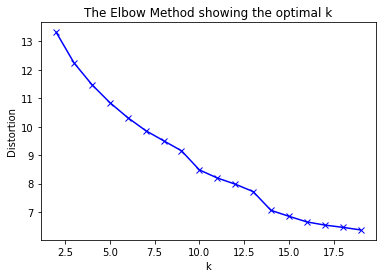

In [8]:
from sklearn.cluster import KMeans
from sklearn import metrics
from scipy.spatial.distance import cdist
import numpy as np
import matplotlib.pyplot as plt
distortions = []
inertias = []
K = range(2,20)
X = cp_numerical_test
for k in K:
    kmeanModel = KMeans(n_clusters=k, init="random", n_init=20, random_state=42)
    kmeanModel.fit(X)
    distortions.append(sum(np.square(np.min(cdist(X, kmeanModel.cluster_centers_,'euclidean'), axis=1)) / X.shape[0]))
    inertias.append(kmeanModel.inertia_)
plt.plot(K, distortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Distortion')
plt.title('The Elbow Method showing the optimal k')
plt.show()

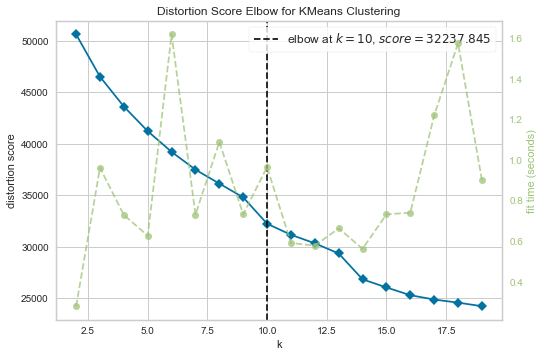

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [11]:

from yellowbrick.cluster import KElbowVisualizer
kmeanModel = KMeans(init="random", n_init=20, random_state=42)
visualizer = KElbowVisualizer(kmeanModel, k=(2,20))

visualizer.fit(X)        # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

In [12]:
kmeans = KMeans(n_clusters=10, init="random", n_init=20, random_state=42)
cp_numerical_cluster = cp_numerical_test.copy()
cp_numerical_cluster['cluster'] = kmeans.fit_predict(cp_numerical_cluster)


In [13]:
cp_numerical_cluster

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,num_user_for_reviews,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,cluster
0,4.509574,2.988320,-0.261782,0.048394,-0.432019,10.105344,5.159032,-0.345573,-0.671875,6.635281,0.850706,0.603048,-0.235919,1.355991,-0.937143,1.111495,3
1,1.102006,2.591595,-0.077230,0.125353,2.092889,3.671276,2.419630,1.939536,-0.671875,2.205953,1.131092,0.402085,0.662424,0.599492,0.680759,-0.433692,3
2,3.530201,1.665902,-0.261782,-0.319947,0.215393,2.111901,1.130068,0.014974,-0.184695,1.610823,0.886311,1.205936,-0.355948,0.315805,0.680759,3.546335,1
3,5.238032,2.371192,6.949846,11.801863,1.251253,5.649934,6.863025,5.006706,-0.671875,5.774294,0.908564,0.904492,4.641305,1.923366,0.680759,7.245420,9
5,2.397044,0.960612,-0.106076,-0.124100,-0.455326,0.300278,0.709808,-0.501061,-0.184695,0.986424,0.969537,0.904492,-0.303118,0.126680,0.680759,0.690080,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5027,-0.824362,-0.890774,-0.131645,-0.405398,-0.496436,-0.732149,-0.660929,-0.599153,-0.671875,-0.750185,-0.204036,-0.301286,-0.442821,0.977742,-0.738454,-0.401056,6
5029,-0.711046,0.034919,-0.241458,-0.402213,-0.490998,-0.740409,-0.649291,-0.593377,-0.671875,-0.691648,-0.199629,-0.602730,-0.439947,0.883179,-0.738454,-0.395437,0
5033,-0.184937,-1.463822,-0.166392,-0.401152,-0.477920,-0.735700,-0.211491,-0.580092,-0.671875,0.091290,-0.204049,0.100640,-0.432873,0.504930,-0.738454,0.455961,6
5035,-0.889114,-1.287500,-0.261782,-0.402213,-0.488926,-0.712649,-0.347371,-0.591697,-0.671875,-0.496523,-0.204049,-1.105138,-0.438400,0.410367,-2.100898,-0.433692,6


In [14]:
centroids = kmeans.cluster_centers_
cen_x = [i[0] for i in centroids] 
cen_y = [i[1] for i in centroids]

## add to df
cp_numerical_cluster['cen_x'] = cp_numerical_cluster.cluster.map({0:cen_x[0], 1:cen_x[1], 2:cen_x[2], 3:cen_x[3],
                                                                 4:cen_x[4], 5:cen_x[5], 6:cen_x[6], 7:cen_x[7],
                                                                8:cen_x[8], 9:cen_x[9]})
cp_numerical_cluster['cen_y'] = cp_numerical_cluster.cluster.map({0:cen_y[0], 1:cen_y[1], 2:cen_y[2], 3:cen_y[3],
                                                                 4:cen_y[4], 5:cen_y[5], 6:cen_y[6], 7:cen_y[7],
                                                                8:cen_x[8], 9:cen_x[9]})

colors = ['#DF2020', '#DF8620', '#D9DF20', '#56DF20', '#20DFCC', '#2080DF', '#202ADF', '#8020DF', '#DF20D2', '#a832a2', '#a8325f']
cp_numerical_cluster['c'] = cp_numerical_cluster.cluster.map({0:colors[0], 1:colors[1], 2:colors[2], 3:colors[3], 4:colors[4], 5:colors[5],
                        6:colors[6], 7:colors[7], 8:colors[8], 9:colors[9]})

In [15]:
cp_numerical_cluster

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,num_user_for_reviews,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,cluster,cen_x,cen_y,c
0,4.509574,2.988320,-0.261782,0.048394,-0.432019,10.105344,5.159032,-0.345573,-0.671875,6.635281,0.850706,0.603048,-0.235919,1.355991,-0.937143,1.111495,3,1.077441,1.090696,#56DF20
1,1.102006,2.591595,-0.077230,0.125353,2.092889,3.671276,2.419630,1.939536,-0.671875,2.205953,1.131092,0.402085,0.662424,0.599492,0.680759,-0.433692,3,1.077441,1.090696,#56DF20
2,3.530201,1.665902,-0.261782,-0.319947,0.215393,2.111901,1.130068,0.014974,-0.184695,1.610823,0.886311,1.205936,-0.355948,0.315805,0.680759,3.546335,1,2.497640,0.668936,#DF8620
3,5.238032,2.371192,6.949846,11.801863,1.251253,5.649934,6.863025,5.006706,-0.671875,5.774294,0.908564,0.904492,4.641305,1.923366,0.680759,7.245420,9,1.356581,1.356581,#a832a2
5,2.397044,0.960612,-0.106076,-0.124100,-0.455326,0.300278,0.709808,-0.501061,-0.184695,0.986424,0.969537,0.904492,-0.303118,0.126680,0.680759,0.690080,8,0.429670,0.429670,#DF20D2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5027,-0.824362,-0.890774,-0.131645,-0.405398,-0.496436,-0.732149,-0.660929,-0.599153,-0.671875,-0.750185,-0.204036,-0.301286,-0.442821,0.977742,-0.738454,-0.401056,6,-0.664515,-0.571380,#202ADF
5029,-0.711046,0.034919,-0.241458,-0.402213,-0.490998,-0.740409,-0.649291,-0.593377,-0.671875,-0.691648,-0.199629,-0.602730,-0.439947,0.883179,-0.738454,-0.395437,0,-0.591844,0.840500,#DF2020
5033,-0.184937,-1.463822,-0.166392,-0.401152,-0.477920,-0.735700,-0.211491,-0.580092,-0.671875,0.091290,-0.204049,0.100640,-0.432873,0.504930,-0.738454,0.455961,6,-0.664515,-0.571380,#202ADF
5035,-0.889114,-1.287500,-0.261782,-0.402213,-0.488926,-0.712649,-0.347371,-0.591697,-0.671875,-0.496523,-0.204049,-1.105138,-0.438400,0.410367,-2.100898,-0.433692,6,-0.664515,-0.571380,#202ADF


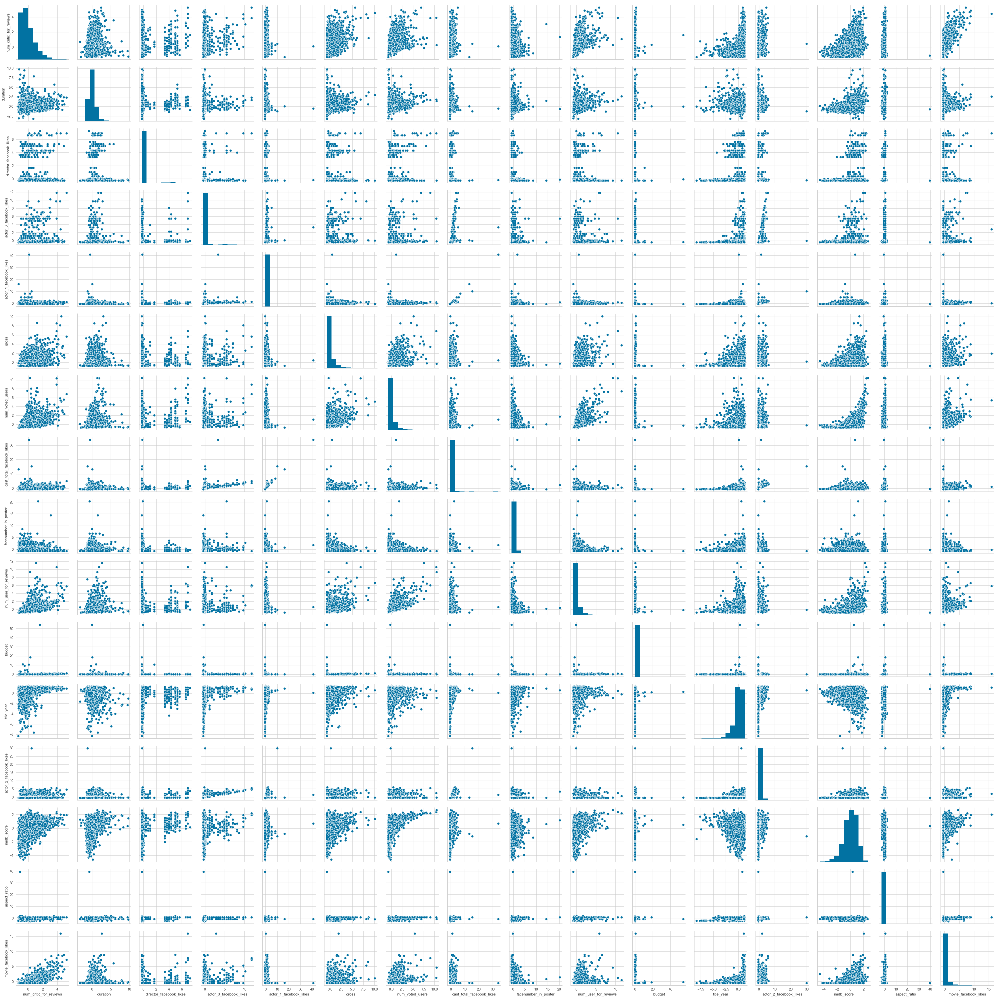

In [16]:
import matplotlib.pyplot as plt
from pandas.plotting import scatter_matrix
import seaborn as sns
%matplotlib widget
sns.pairplot(cp_numerical)

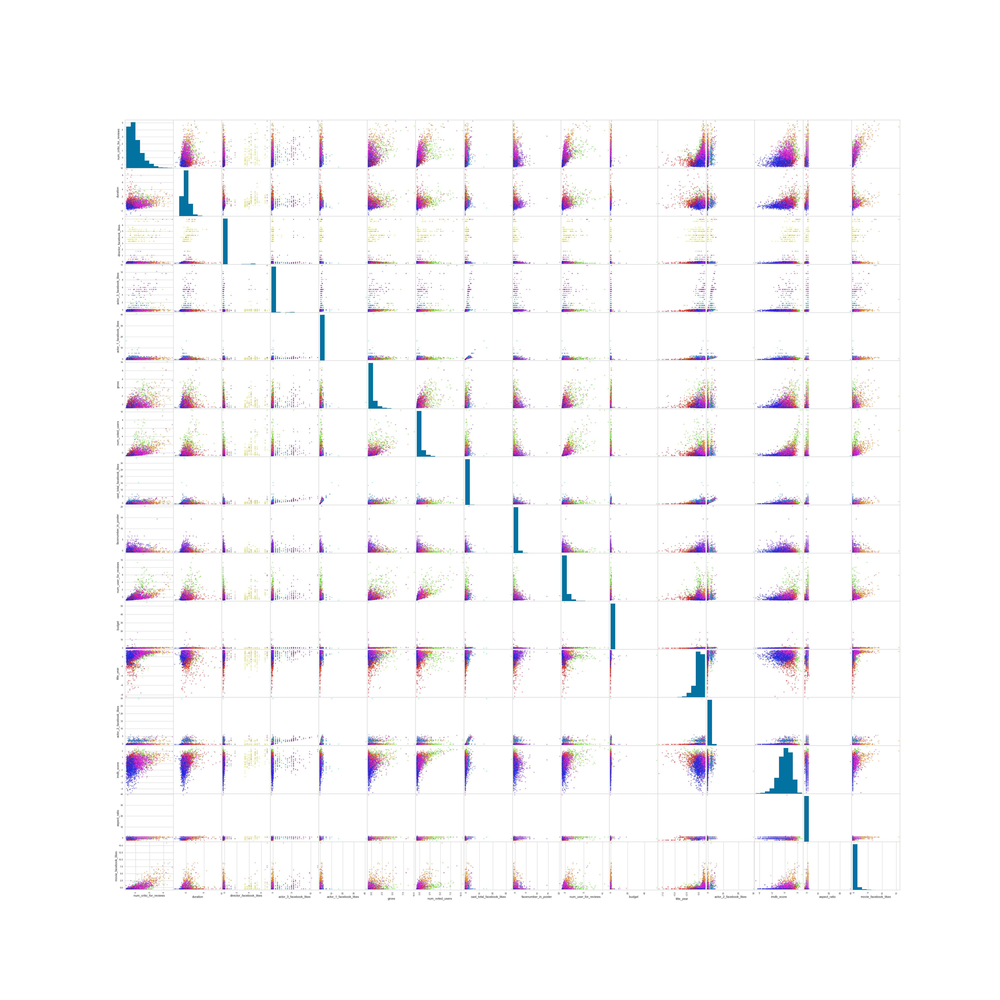

In [58]:
%matplotlib widget
pd.plotting.scatter_matrix(cp_numerical, c=cp_numerical_cluster.c, figsize = [50,50]);

In [28]:
cp_numerical_gross_drop = cp_numerical.drop('gross', 1)

NameError: name 'cp_numerical' is not defined

In [31]:
cp_numerical_gross_drop

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,num_user_for_reviews,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
0,723.0,178.0,0.0,855.0,1000.0,886204,4834,0.0,3054.0,237000000.0,2009.0,936.0,7.9,1.78,33000
1,302.0,169.0,563.0,1000.0,40000.0,471220,48350,0.0,1238.0,300000000.0,2007.0,5000.0,7.1,2.35,0
2,602.0,148.0,0.0,161.0,11000.0,275868,11700,1.0,994.0,245000000.0,2015.0,393.0,6.8,2.35,85000
3,813.0,164.0,22000.0,23000.0,27000.0,1144337,106759,0.0,2701.0,250000000.0,2012.0,23000.0,8.5,2.35,164000
5,462.0,132.0,475.0,530.0,640.0,212204,1873,1.0,738.0,263700000.0,2012.0,632.0,6.6,2.35,24000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5027,64.0,90.0,397.0,0.0,5.0,4555,5,0.0,26.0,10000.0,2000.0,0.0,7.5,1.85,697
5029,78.0,111.0,62.0,6.0,89.0,6318,115,0.0,50.0,1000000.0,1997.0,13.0,7.4,1.85,817
5033,143.0,77.0,291.0,8.0,291.0,72639,368,0.0,371.0,7000.0,2004.0,45.0,7.0,1.85,19000
5035,56.0,81.0,0.0,6.0,121.0,52055,147,0.0,130.0,7000.0,1992.0,20.0,6.9,1.37,0


## Categorical Kmodes

In [9]:
cp_df_original = df_original
# encoded_df = pd.get_dummies(cp_df_original[['color', 'director_name', 'actor_1_name', 'actor_2_name', 'actor_3_name', 'content_rating', 'country', 'genres']])
# cp_df_original[encoded_df.columns] = encoded_df[encoded_df.columns]

cp_categorical = df_original[['color', 'director_name', 'actor_1_name', 'actor_2_name', 'actor_3_name', 'content_rating', 'country', 'genres', 'movie_title']]

In [10]:
# cp_categorical['actor_1_name'] = cp_categorical['actor_1_name'].replace(np.nan, 'unknown') # replacing null values to "unknown"
# cp_categorical['actor_2_name'] = cp_categorical['actor_2_name'].replace(np.nan, 'unknown')
# cp_categorical['actor_3_name'] = cp_categorical['actor_3_name'].replace(np.nan, 'unknown')
# cp_categorical['director_name'] = cp_categorical['director_name'].replace(np.nan, 'unknown')
# df_original['director_name'] = df_original['director_name'].replace(np.nan, 'unknown')

In [11]:
cp_categorical

,color,director_name,actor_1_name,actor_2_name,actor_3_name,content_rating,country,genres,movie_title
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Action|Adventure|Fantasy|Sci-Fi,Avatar
1,Color,Gore Verbinski,Johnny Depp,Orlando Bloom,Jack Davenport,PG-13,USA,Action|Adventure|Fantasy,Pirates of the Caribbean: At World's End
2,Color,Sam Mendes,Christoph Waltz,Rory Kinnear,Stephanie Sigman,PG-13,UK,Action|Adventure|Thriller,Spectre
3,Color,Christopher Nolan,Tom Hardy,Christian Bale,Joseph Gordon-Levitt,PG-13,USA,Action|Thriller,The Dark Knight Rises
4,NaN,Doug Walker,Doug Walker,Rob Walker,NaN,NaN,NaN,Documentary,Star Wars: Episode VII - The Force Awakens ...
...,...,...,...,...,...,...,...,...,...
5038,Color,Scott Smith,Eric Mabius,Daphne Zuniga,Crystal Lowe,NaN,Canada,Comedy|Drama,Signed Sealed Delivered
5039,Color,NaN,Natalie Zea,Valorie Curry,Sam Underwood,TV-14,USA,Crime|Drama|Mystery|Thriller,The Following
5040,Color,Benjamin Roberds,Eva Boehnke,Maxwell Moody,David Chandler,NaN,USA,Drama|Horror|Thriller,A Plague So Pleasant
5041,Color,Daniel Hsia,Alan Ruck,Daniel Henney,Eliza Coupe,PG-13,USA,Comedy|Drama|Romance,Shanghai Calling


In [12]:
cp_categorical['genres'] = cp_categorical['genres'].str.replace('|', ' ') # removing unnessesary bars

/Users/SRI/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [13]:
cp_categorical

,color,director_name,actor_1_name,actor_2_name,actor_3_name,content_rating,country,genres,movie_title
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Action Adventure Fantasy Sci-Fi,Avatar
1,Color,Gore Verbinski,Johnny Depp,Orlando Bloom,Jack Davenport,PG-13,USA,Action Adventure Fantasy,Pirates of the Caribbean: At World's End
2,Color,Sam Mendes,Christoph Waltz,Rory Kinnear,Stephanie Sigman,PG-13,UK,Action Adventure Thriller,Spectre
3,Color,Christopher Nolan,Tom Hardy,Christian Bale,Joseph Gordon-Levitt,PG-13,USA,Action Thriller,The Dark Knight Rises
4,NaN,Doug Walker,Doug Walker,Rob Walker,NaN,NaN,NaN,Documentary,Star Wars: Episode VII - The Force Awakens ...
...,...,...,...,...,...,...,...,...,...
5038,Color,Scott Smith,Eric Mabius,Daphne Zuniga,Crystal Lowe,NaN,Canada,Comedy Drama,Signed Sealed Delivered
5039,Color,NaN,Natalie Zea,Valorie Curry,Sam Underwood,TV-14,USA,Crime Drama Mystery Thriller,The Following
5040,Color,Benjamin Roberds,Eva Boehnke,Maxwell Moody,David Chandler,NaN,USA,Drama Horror Thriller,A Plague So Pleasant
5041,Color,Daniel Hsia,Alan Ruck,Daniel Henney,Eliza Coupe,PG-13,USA,Comedy Drama Romance,Shanghai Calling


In [14]:
cp_categorical['movie_title'] = cp_categorical['movie_title'].str.lower()
cp_categorical

/Users/SRI/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,color,director_name,actor_1_name,actor_2_name,actor_3_name,content_rating,country,genres,movie_title
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Action Adventure Fantasy Sci-Fi,avatar
1,Color,Gore Verbinski,Johnny Depp,Orlando Bloom,Jack Davenport,PG-13,USA,Action Adventure Fantasy,pirates of the caribbean: at world's end
2,Color,Sam Mendes,Christoph Waltz,Rory Kinnear,Stephanie Sigman,PG-13,UK,Action Adventure Thriller,spectre
3,Color,Christopher Nolan,Tom Hardy,Christian Bale,Joseph Gordon-Levitt,PG-13,USA,Action Thriller,the dark knight rises
4,NaN,Doug Walker,Doug Walker,Rob Walker,NaN,NaN,NaN,Documentary,star wars: episode vii - the force awakens ...
...,...,...,...,...,...,...,...,...,...
5038,Color,Scott Smith,Eric Mabius,Daphne Zuniga,Crystal Lowe,NaN,Canada,Comedy Drama,signed sealed delivered
5039,Color,NaN,Natalie Zea,Valorie Curry,Sam Underwood,TV-14,USA,Crime Drama Mystery Thriller,the following
5040,Color,Benjamin Roberds,Eva Boehnke,Maxwell Moody,David Chandler,NaN,USA,Drama Horror Thriller,a plague so pleasant
5041,Color,Daniel Hsia,Alan Ruck,Daniel Henney,Eliza Coupe,PG-13,USA,Comedy Drama Romance,shanghai calling


In [15]:
#cp_categorical['movie_title'] = cp_categorical['movie_title'].apply(lambda x : x[:-1]) # removing unnessesary chars at the end of the titile
# cp_categorical

In [16]:
from tmdbv3api import TMDb
import json
import requests
from tmdbv3api import Movie
tmdb = TMDb()
tmdb.api_key = '87f1f400a3e1445d86fdd4366532e611'

In [17]:
# fetching genres using API
tmdb_movie = Movie()
def get_genre(x):    
        genres = []
        result = tmdb_movie.search(x)
        if result != []:
                movie_id = result[0].id
                response = requests.get('https://api.themoviedb.org/3/movie/{}?api_key={}'.format(movie_id,tmdb.api_key))
                data_json = response.json()
                if data_json['genres']:
                        genre_str = " " 
                        for i in range(len(data_json['genres'])):
                                genres.append(data_json['genres'][i]['name'])
                        return genre_str.join(genres)

In [18]:
# scraping movies 2018 to 2022 from wikipedia
movies_info = []

for i in range(5):
    link = "https://en.wikipedia.org/wiki/List_of_American_films_of_" + str(i+2018)
    df1 = pd.read_html(link, header=0)[2]
    df2 = pd.read_html(link, header=0)[3]
    df3 = pd.read_html(link, header=0)[4]
    df4 = pd.read_html(link, header=0)[5]
    df = df1.append(df2.append(df3.append(df4,ignore_index=True),ignore_index=True),ignore_index=True)

    movies_info.append(df)

In [19]:
movies_info

[      Opening  Opening.1                       Title  \
 0     JANUARY          5     Insidious: The Last Key   
 1     JANUARY          5            The Strange Ones   
 2     JANUARY          5                    Stratton   
 3     JANUARY         10               Sweet Country   
 4     JANUARY         12                The Commuter   
 ..        ...        ...                         ...   
 267  DECEMBER         25             Holmes & Watson   
 268  DECEMBER         25                        Vice   
 269  DECEMBER         25         On the Basis of Sex   
 270  DECEMBER         25                   Destroyer   
 271  DECEMBER         28  Black Mirror: Bandersnatch   
 
                                     Production company  \
 0    Universal Pictures / Blumhouse Productions / S...   
 1                               Vertical Entertainment   
 2                                    Momentum Pictures   
 3                                 Samuel Goldwyn Films   
 4        Lionsgate

In [20]:
# adding the genre to the column for each dataset
for i in range(5):
    movies_info[i]['genres'] = movies_info[i]['Title'].map(lambda x: get_genre(str(x)))

In [21]:
# setting up functions to get each person from Cast and crew
def get_director(x):
    if " (director)" in x:
        return x.split(" (director)")[0]
    elif " (directors)" in x:
        return x.split(" (directors)")[0]
    else:
        return x.split(" (director/screenplay)")[0]

def get_actor1(x):
    return ((x.split("screenplay); ")[-1]).split(", ")[0])

def get_actor2(x):
    if len((x.split("screenplay); ")[-1]).split(", ")) < 2:
        return np.NaN
    else:
        return ((x.split("screenplay); ")[-1]).split(", ")[1])
    
def get_actor3(x):
    if len((x.split("screenplay); ")[-1]).split(", ")) < 3:
        return np.NaN
    else:
        return ((x.split("screenplay); ")[-1]).split(", ")[2])

In [22]:
for i in range(5):
    movies_info[i] = movies_info[i][['Title','Cast and crew','genres']]
    movies_info[i] = movies_info[i].rename(columns={'Title':'movie_title'})
    movies_info[i]['director_name'] = movies_info[i]['Cast and crew'].map(lambda x: get_director(str(x)))
    movies_info[i]['actor_1_name'] = movies_info[i]['Cast and crew'].map(lambda x: get_actor1(str(x)))
    movies_info[i]['actor_2_name'] = movies_info[i]['Cast and crew'].map(lambda x: get_actor2(str(x)))
    movies_info[i]['actor_3_name'] = movies_info[i]['Cast and crew'].map(lambda x: get_actor3(str(x)))
    movies_info[i].loc[:,['director_name','actor_1_name','actor_2_name','actor_3_name','genres','movie_title']]
    movies_info[i]['movie_title'] = movies_info[i]['movie_title'].str.lower()
    movies_info[i]['comb'] = movies_info[i]['actor_1_name'] + ' ' + movies_info[i]['actor_2_name'] + ' '+ movies_info[i]['actor_3_name'] + ' '+ movies_info[i]['director_name'] +' ' + movies_info[i]['genres']


In [23]:
movies_info[4]

,movie_title,Cast and crew,genres,director_name,actor_1_name,actor_2_name,actor_3_name,comb
0,doctor strange in the multiverse of madness*,NaN,Fantasy Action Adventure,nan,nan,NaN,NaN,NaN
1,the batman*,NaN,Crime Mystery Thriller,nan,nan,NaN,NaN,NaN
2,top gun: maverick*,NaN,Action Drama,nan,nan,NaN,NaN,NaN
3,sonic the hedgehog 2*,NaN,Action Adventure Family Comedy,nan,nan,NaN,NaN,NaN
4,uncharted,NaN,Action Adventure,nan,nan,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...
180,"are you there god? it's me, margaret",Kelly Fremon Craig (director/screenplay); Rach...,Drama Comedy,Kelly Fremon Craig,Rachel McAdams,Abby Ryder Fortson,Benny Safdie,Rachel McAdams Abby Ryder Fortson Benny Safdie...
181,distant,Josh Gordon & Will Speck (directors); Spenser ...,Science Fiction Comedy Romance,Josh Gordon & Will Speck,Anthony Ramos,Naomi Scott,Zachary Quinto,Anthony Ramos Naomi Scott Zachary Quinto Josh ...
182,don't worry darling,Olivia Wilde (director); Katie Silberman (scre...,Drama Mystery Thriller,Olivia Wilde,Florence Pugh,Harry Styles,Olivia Wilde,Florence Pugh Harry Styles Olivia Wilde Olivia...
183,hocus pocus 2,Anne Fletcher (director); Jen D'Angelo (screen...,Fantasy Family Comedy,Anne Fletcher,Bette Midler,Sarah Jessica Parker,Kathy Najimy,Bette Midler Sarah Jessica Parker Kathy Najimy...


In [25]:
cp_categorical

,color,director_name,actor_1_name,actor_2_name,actor_3_name,content_rating,country,genres,movie_title
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Action Adventure Fantasy Sci-Fi,avatar
1,Color,Gore Verbinski,Johnny Depp,Orlando Bloom,Jack Davenport,PG-13,USA,Action Adventure Fantasy,pirates of the caribbean: at world's end
2,Color,Sam Mendes,Christoph Waltz,Rory Kinnear,Stephanie Sigman,PG-13,UK,Action Adventure Thriller,spectre
3,Color,Christopher Nolan,Tom Hardy,Christian Bale,Joseph Gordon-Levitt,PG-13,USA,Action Thriller,the dark knight rises
4,NaN,Doug Walker,Doug Walker,Rob Walker,NaN,NaN,NaN,Documentary,star wars: episode vii - the force awakens ...
...,...,...,...,...,...,...,...,...,...
5038,Color,Scott Smith,Eric Mabius,Daphne Zuniga,Crystal Lowe,NaN,Canada,Comedy Drama,signed sealed delivered
5039,Color,NaN,Natalie Zea,Valorie Curry,Sam Underwood,TV-14,USA,Crime Drama Mystery Thriller,the following
5040,Color,Benjamin Roberds,Eva Boehnke,Maxwell Moody,David Chandler,NaN,USA,Drama Horror Thriller,a plague so pleasant
5041,Color,Daniel Hsia,Alan Ruck,Daniel Henney,Eliza Coupe,PG-13,USA,Comedy Drama Romance,shanghai calling


In [27]:
new_df = pd.concat([movies_info[0], movies_info[1], movies_info[2], movies_info[3], movies_info[4]], ignore_index=True)
cp_categorical_final = cp_categorical.append(new_df,ignore_index=True)
cp_categorical_final['movie_title'] = cp_categorical_final['movie_title'].str.replace('\xa0', '')
cp_categorical_final = cp_categorical_final.drop("Cast and crew",axis=1)
cp_categorical_final

,color,director_name,actor_1_name,actor_2_name,actor_3_name,content_rating,country,genres,movie_title,comb
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Action Adventure Fantasy Sci-Fi,avatar,NaN
1,Color,Gore Verbinski,Johnny Depp,Orlando Bloom,Jack Davenport,PG-13,USA,Action Adventure Fantasy,pirates of the caribbean: at world's end,NaN
2,Color,Sam Mendes,Christoph Waltz,Rory Kinnear,Stephanie Sigman,PG-13,UK,Action Adventure Thriller,spectre,NaN
3,Color,Christopher Nolan,Tom Hardy,Christian Bale,Joseph Gordon-Levitt,PG-13,USA,Action Thriller,the dark knight rises,NaN
4,NaN,Doug Walker,Doug Walker,Rob Walker,NaN,NaN,NaN,Documentary,star wars: episode vii - the force awakens ...,NaN
...,...,...,...,...,...,...,...,...,...,...
6370,NaN,Kelly Fremon Craig,Rachel McAdams,Abby Ryder Fortson,Benny Safdie,NaN,NaN,Drama Comedy,"are you there god? it's me, margaret",Rachel McAdams Abby Ryder Fortson Benny Safdie...
6371,NaN,Josh Gordon & Will Speck,Anthony Ramos,Naomi Scott,Zachary Quinto,NaN,NaN,Science Fiction Comedy Romance,distant,Anthony Ramos Naomi Scott Zachary Quinto Josh ...
6372,NaN,Olivia Wilde,Florence Pugh,Harry Styles,Olivia Wilde,NaN,NaN,Drama Mystery Thriller,don't worry darling,Florence Pugh Harry Styles Olivia Wilde Olivia...
6373,NaN,Anne Fletcher,Bette Midler,Sarah Jessica Parker,Kathy Najimy,NaN,NaN,Fantasy Family Comedy,hocus pocus 2,Bette Midler Sarah Jessica Parker Kathy Najimy...


In [28]:
cp_categorical_final = cp_categorical_final.fillna('')
cp_categorical_final

,color,director_name,actor_1_name,actor_2_name,actor_3_name,content_rating,country,genres,movie_title,comb
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Action Adventure Fantasy Sci-Fi,avatar,
1,Color,Gore Verbinski,Johnny Depp,Orlando Bloom,Jack Davenport,PG-13,USA,Action Adventure Fantasy,pirates of the caribbean: at world's end,
2,Color,Sam Mendes,Christoph Waltz,Rory Kinnear,Stephanie Sigman,PG-13,UK,Action Adventure Thriller,spectre,
3,Color,Christopher Nolan,Tom Hardy,Christian Bale,Joseph Gordon-Levitt,PG-13,USA,Action Thriller,the dark knight rises,
4,,Doug Walker,Doug Walker,Rob Walker,,,,Documentary,star wars: episode vii - the force awakens ...,
...,...,...,...,...,...,...,...,...,...,...
6370,,Kelly Fremon Craig,Rachel McAdams,Abby Ryder Fortson,Benny Safdie,,,Drama Comedy,"are you there god? it's me, margaret",Rachel McAdams Abby Ryder Fortson Benny Safdie...
6371,,Josh Gordon & Will Speck,Anthony Ramos,Naomi Scott,Zachary Quinto,,,Science Fiction Comedy Romance,distant,Anthony Ramos Naomi Scott Zachary Quinto Josh ...
6372,,Olivia Wilde,Florence Pugh,Harry Styles,Olivia Wilde,,,Drama Mystery Thriller,don't worry darling,Florence Pugh Harry Styles Olivia Wilde Olivia...
6373,,Anne Fletcher,Bette Midler,Sarah Jessica Parker,Kathy Najimy,,,Fantasy Family Comedy,hocus pocus 2,Bette Midler Sarah Jessica Parker Kathy Najimy...


In [29]:
for i, genre in enumerate(cp_categorical_final['genres']): # genres has a few attributes so we have to splite each genre
    cp_categorical_final['genres'][i] = str(genre).split()
cp_categorical_final

,color,director_name,actor_1_name,actor_2_name,actor_3_name,content_rating,country,genres,movie_title,comb
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,"[Action, Adventure, Fantasy, Sci-Fi]",avatar,
1,Color,Gore Verbinski,Johnny Depp,Orlando Bloom,Jack Davenport,PG-13,USA,"[Action, Adventure, Fantasy]",pirates of the caribbean: at world's end,
2,Color,Sam Mendes,Christoph Waltz,Rory Kinnear,Stephanie Sigman,PG-13,UK,"[Action, Adventure, Thriller]",spectre,
3,Color,Christopher Nolan,Tom Hardy,Christian Bale,Joseph Gordon-Levitt,PG-13,USA,"[Action, Thriller]",the dark knight rises,
4,,Doug Walker,Doug Walker,Rob Walker,,,,[Documentary],star wars: episode vii - the force awakens ...,
...,...,...,...,...,...,...,...,...,...,...
6370,,Kelly Fremon Craig,Rachel McAdams,Abby Ryder Fortson,Benny Safdie,,,"[Drama, Comedy]","are you there god? it's me, margaret",Rachel McAdams Abby Ryder Fortson Benny Safdie...
6371,,Josh Gordon & Will Speck,Anthony Ramos,Naomi Scott,Zachary Quinto,,,"[Science, Fiction, Comedy, Romance]",distant,Anthony Ramos Naomi Scott Zachary Quinto Josh ...
6372,,Olivia Wilde,Florence Pugh,Harry Styles,Olivia Wilde,,,"[Drama, Mystery, Thriller]",don't worry darling,Florence Pugh Harry Styles Olivia Wilde Olivia...
6373,,Anne Fletcher,Bette Midler,Sarah Jessica Parker,Kathy Najimy,,,"[Fantasy, Family, Comedy]",hocus pocus 2,Bette Midler Sarah Jessica Parker Kathy Najimy...


In [36]:
cp_categorical_final

,color,director_name,actor_1_name,actor_2_name,actor_3_name,content_rating,country,genres,movie_title,comb
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,"[Action, Adventure, Fantasy, Sci-Fi]",avatar,
1,Color,Gore Verbinski,Johnny Depp,Orlando Bloom,Jack Davenport,PG-13,USA,"[Action, Adventure, Fantasy]",pirates of the caribbean: at world's end,
2,Color,Sam Mendes,Christoph Waltz,Rory Kinnear,Stephanie Sigman,PG-13,UK,"[Action, Adventure, Thriller]",spectre,
3,Color,Christopher Nolan,Tom Hardy,Christian Bale,Joseph Gordon-Levitt,PG-13,USA,"[Action, Thriller]",the dark knight rises,
4,,Doug Walker,Doug Walker,Rob Walker,,,,[Documentary],star wars: episode vii - the force awakens ...,
...,...,...,...,...,...,...,...,...,...,...
6370,,Kelly Fremon Craig,Rachel McAdams,Abby Ryder Fortson,Benny Safdie,,,"[Drama, Comedy]","are you there god? it's me, margaret",Rachel McAdams Abby Ryder Fortson Benny Safdie...
6371,,Josh Gordon & Will Speck,Anthony Ramos,Naomi Scott,Zachary Quinto,,,"[Science, Fiction, Comedy, Romance]",distant,Anthony Ramos Naomi Scott Zachary Quinto Josh ...
6372,,Olivia Wilde,Florence Pugh,Harry Styles,Olivia Wilde,,,"[Drama, Mystery, Thriller]",don't worry darling,Florence Pugh Harry Styles Olivia Wilde Olivia...
6373,,Anne Fletcher,Bette Midler,Sarah Jessica Parker,Kathy Najimy,,,"[Fantasy, Family, Comedy]",hocus pocus 2,Bette Midler Sarah Jessica Parker Kathy Najimy...


In [30]:
df_out = cp_categorical_final.explode('genres')

In [31]:
df_out

,color,director_name,actor_1_name,actor_2_name,actor_3_name,content_rating,country,genres,movie_title,comb
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Action,avatar,
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Adventure,avatar,
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Fantasy,avatar,
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Sci-Fi,avatar,
1,Color,Gore Verbinski,Johnny Depp,Orlando Bloom,Jack Davenport,PG-13,USA,Action,pirates of the caribbean: at world's end,
...,...,...,...,...,...,...,...,...,...,...
6374,,Nicholas Stoller,Billy Eichner,Luke Macfarlane,Ts Madison,,,Adventure,bros,Billy Eichner Luke Macfarlane Ts Madison Nicho...
6374,,Nicholas Stoller,Billy Eichner,Luke Macfarlane,Ts Madison,,,Comedy,bros,Billy Eichner Luke Macfarlane Ts Madison Nicho...
6374,,Nicholas Stoller,Billy Eichner,Luke Macfarlane,Ts Madison,,,Family,bros,Billy Eichner Luke Macfarlane Ts Madison Nicho...
6374,,Nicholas Stoller,Billy Eichner,Luke Macfarlane,Ts Madison,,,Science,bros,Billy Eichner Luke Macfarlane Ts Madison Nicho...


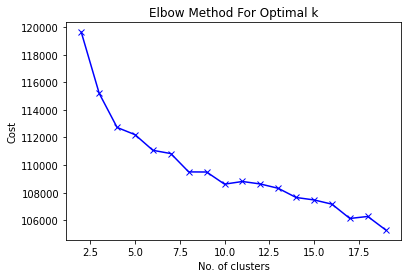

In [106]:
# from sklearn.cluster import KMeans
from sklearn import metrics
from scipy.spatial.distance import cdist
import numpy as np
import matplotlib.pyplot as plt
from kmodes.kmodes import KModes
distortions = []
inertias = []
K = range(2,20)
X = df_out
cost = []
for num_clusters in list(K):
    kmode = KModes(n_clusters=num_clusters, init = "random", n_init = 5, verbose=0)
    kmode.fit_predict(X)
    cost.append(kmode.cost_)
plt.plot(K, cost, 'bx-')
plt.xlabel('No. of clusters')
plt.ylabel('Cost')
plt.title('Elbow Method For Optimal k')
plt.show()

In [109]:
kmeans = KModes(n_clusters=5, init="random", n_init=5)
df_out_cluster = df_out.copy()
df_out_cluster['cluster'] = kmeans.fit_predict(df_out_cluster)

In [110]:
df_out_cluster

,color,director_name,actor_1_name,actor_2_name,actor_3_name,content_rating,country,genres,movie_title,comb,cluster
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Action,avatar,,4
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Adventure,avatar,,4
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Fantasy,avatar,,4
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Sci-Fi,avatar,,4
1,Color,Gore Verbinski,Johnny Depp,Orlando Bloom,Jack Davenport,PG-13,USA,Action,pirates of the caribbean: at world's end,,4
...,...,...,...,...,...,...,...,...,...,...,...
6368,,Nicholas Stoller,Billy Eichner,Luke Macfarlane,Ts Madison,,,Comedy,bros,Billy Eichner Luke Macfarlane Ts Madison Nicho...,1
6368,,Nicholas Stoller,Billy Eichner,Luke Macfarlane,Ts Madison,,,Family,bros,Billy Eichner Luke Macfarlane Ts Madison Nicho...,1
6368,,Nicholas Stoller,Billy Eichner,Luke Macfarlane,Ts Madison,,,Science,bros,Billy Eichner Luke Macfarlane Ts Madison Nicho...,1
6368,,Nicholas Stoller,Billy Eichner,Luke Macfarlane,Ts Madison,,,Fiction,bros,Billy Eichner Luke Macfarlane Ts Madison Nicho...,1


In [112]:
colors = ['#DF2020', '#DF8620', '#D9DF20', '#56DF20', '#20DFCC', '#2080DF', '#202ADF', '#8020DF', '#DF20D2', '#a832a2', '#a8325f']
df_out_cluster['c'] = df_out_cluster.cluster.map({0:colors[0], 1:colors[1], 2:colors[2], 3:colors[3], 4:colors[4], 5:colors[5],
                        6:colors[6], 7:colors[7], 8:colors[8], 9:colors[9]})

In [113]:
df_out_cluster

,color,director_name,actor_1_name,actor_2_name,actor_3_name,content_rating,country,genres,movie_title,comb,cluster,c
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Action,avatar,,4,#20DFCC
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Adventure,avatar,,4,#20DFCC
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Fantasy,avatar,,4,#20DFCC
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Sci-Fi,avatar,,4,#20DFCC
1,Color,Gore Verbinski,Johnny Depp,Orlando Bloom,Jack Davenport,PG-13,USA,Action,pirates of the caribbean: at world's end,,4,#20DFCC
...,...,...,...,...,...,...,...,...,...,...,...,...
6368,,Nicholas Stoller,Billy Eichner,Luke Macfarlane,Ts Madison,,,Comedy,bros,Billy Eichner Luke Macfarlane Ts Madison Nicho...,1,#DF8620
6368,,Nicholas Stoller,Billy Eichner,Luke Macfarlane,Ts Madison,,,Family,bros,Billy Eichner Luke Macfarlane Ts Madison Nicho...,1,#DF8620
6368,,Nicholas Stoller,Billy Eichner,Luke Macfarlane,Ts Madison,,,Science,bros,Billy Eichner Luke Macfarlane Ts Madison Nicho...,1,#DF8620
6368,,Nicholas Stoller,Billy Eichner,Luke Macfarlane,Ts Madison,,,Fiction,bros,Billy Eichner Luke Macfarlane Ts Madison Nicho...,1,#DF8620


In [128]:
cp_categorical_final

,color,director_name,actor_1_name,actor_2_name,actor_3_name,content_rating,country,genres,movie_title,comb
0,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,"[Action, Adventure, Fantasy, Sci-Fi]",avatar,
1,Color,Gore Verbinski,Johnny Depp,Orlando Bloom,Jack Davenport,PG-13,USA,"[Action, Adventure, Fantasy]",pirates of the caribbean: at world's end,
2,Color,Sam Mendes,Christoph Waltz,Rory Kinnear,Stephanie Sigman,PG-13,UK,"[Action, Adventure, Thriller]",spectre,
3,Color,Christopher Nolan,Tom Hardy,Christian Bale,Joseph Gordon-Levitt,PG-13,USA,"[Action, Thriller]",the dark knight rises,
4,,Doug Walker,Doug Walker,Rob Walker,,,,[Documentary],star wars: episode vii - the force awakens ...,
...,...,...,...,...,...,...,...,...,...,...
6365,,Kelly Fremon Craig,Rachel McAdams,Abby Ryder Fortson,Benny Safdie,,,"[Drama, Comedy]","are you there god? it's me, margaret",Rachel McAdams Abby Ryder Fortson Benny Safdie...
6366,,Josh Gordon & Will Speck,Anthony Ramos,Naomi Scott,Zachary Quinto,,,"[Science, Fiction, Comedy, Romance]",distant,Anthony Ramos Naomi Scott Zachary Quinto Josh ...
6367,,Olivia Wilde,Florence Pugh,Harry Styles,Olivia Wilde,,,"[Drama, Mystery, Thriller]",don't worry darling,Florence Pugh Harry Styles Olivia Wilde Olivia...
6368,,Nicholas Stoller,Billy Eichner,Luke Macfarlane,Ts Madison,,,"[Adventure, Comedy, Family, Science, Fiction]",bros,Billy Eichner Luke Macfarlane Ts Madison Nicho...


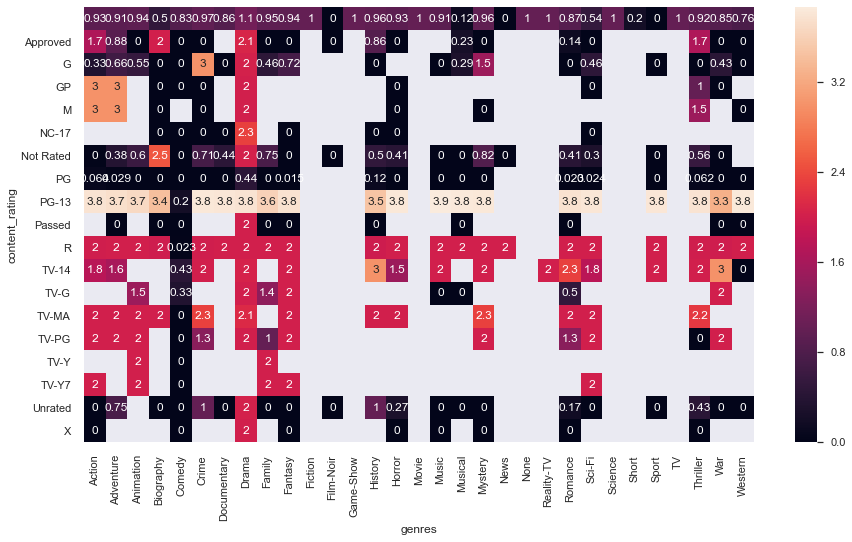

In [121]:
import seaborn as sns
import matplotlib.pyplot as plt

df_heatmap = df_out_cluster.pivot_table(values='cluster',index='content_rating',columns='genres',aggfunc=np.mean)
sns.set(rc = {'figure.figsize':(15,8)})
sns.heatmap(df_heatmap,annot=True)
plt.show()

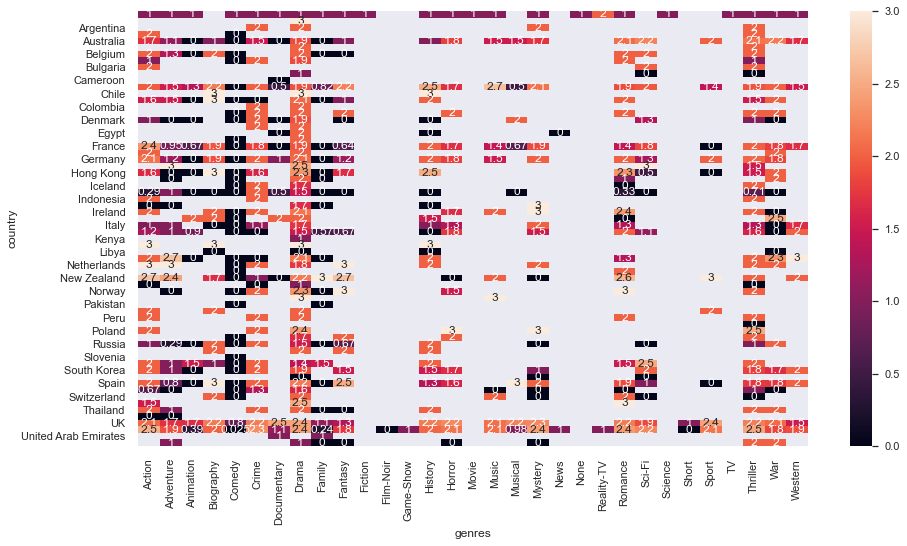

In [120]:
df_heatmap = df_out_cluster.pivot_table(values='cluster',index='country',columns='genres',aggfunc=np.mean)
sns.set(rc = {'figure.figsize':(15,8)})
sns.heatmap(df_heatmap,annot=True)
plt.show()

In [34]:
cp_numerical2['movie_title'][1]

"pirates of the caribbean: at world's end"

In [33]:
cp_numerical2 = cp_df_original.drop(['language', 'movie_imdb_link', 'plot_keywords','color', 'director_name', 'actor_1_name', 'actor_2_name', 'actor_3_name', 'content_rating', 'country', 'genres'], 1)
cp_numerical2['movie_title'] = cp_numerical2['movie_title'].str.lower()
cp_numerical2['movie_title'] = cp_numerical2['movie_title'].str.replace('\xa0', '')
cp_numerical2

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,movie_title,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,num_user_for_reviews,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
0,723.0,178.0,0.0,855.0,1000.0,760505847.0,avatar,886204,4834,0.0,3054.0,237000000.0,2009.0,936.0,7.9,1.78,33000
1,302.0,169.0,563.0,1000.0,40000.0,309404152.0,pirates of the caribbean: at world's end,471220,48350,0.0,1238.0,300000000.0,2007.0,5000.0,7.1,2.35,0
2,602.0,148.0,0.0,161.0,11000.0,200074175.0,spectre,275868,11700,1.0,994.0,245000000.0,2015.0,393.0,6.8,2.35,85000
3,813.0,164.0,22000.0,23000.0,27000.0,448130642.0,the dark knight rises,1144337,106759,0.0,2701.0,250000000.0,2012.0,23000.0,8.5,2.35,164000
4,NaN,NaN,131.0,NaN,131.0,NaN,star wars: episode vii - the force awakens ...,8,143,0.0,NaN,NaN,NaN,12.0,7.1,NaN,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5038,1.0,87.0,2.0,318.0,637.0,NaN,signed sealed delivered,629,2283,2.0,6.0,NaN,2013.0,470.0,7.7,NaN,84
5039,43.0,43.0,NaN,319.0,841.0,NaN,the following,73839,1753,1.0,359.0,NaN,NaN,593.0,7.5,16.00,32000
5040,13.0,76.0,0.0,0.0,0.0,NaN,a plague so pleasant,38,0,0.0,3.0,1400.0,2013.0,0.0,6.3,NaN,16
5041,14.0,100.0,0.0,489.0,946.0,10443.0,shanghai calling,1255,2386,5.0,9.0,NaN,2012.0,719.0,6.3,2.35,660


In [35]:
new_df = cp_numerical2.merge(cp_categorical_final, left_on='movie_title', right_on='movie_title')
new_df

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,movie_title,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,...,movie_facebook_likes,color,director_name,actor_1_name,actor_2_name,actor_3_name,content_rating,country,genres,comb
0,723.0,178.0,0.0,855.0,1000.0,760505847.0,avatar,886204,4834,0.0,...,33000,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,"[Action, Adventure, Fantasy, Sci-Fi]",
1,302.0,169.0,563.0,1000.0,40000.0,309404152.0,pirates of the caribbean: at world's end,471220,48350,0.0,...,0,Color,Gore Verbinski,Johnny Depp,Orlando Bloom,Jack Davenport,PG-13,USA,"[Action, Adventure, Fantasy]",
2,602.0,148.0,0.0,161.0,11000.0,200074175.0,spectre,275868,11700,1.0,...,85000,Color,Sam Mendes,Christoph Waltz,Rory Kinnear,Stephanie Sigman,PG-13,UK,"[Action, Adventure, Thriller]",
3,813.0,164.0,22000.0,23000.0,27000.0,448130642.0,the dark knight rises,1144337,106759,0.0,...,164000,Color,Christopher Nolan,Tom Hardy,Christian Bale,Joseph Gordon-Levitt,PG-13,USA,"[Action, Thriller]",
4,NaN,NaN,131.0,NaN,131.0,NaN,star wars: episode vii - the force awakens ...,8,143,0.0,...,0,,Doug Walker,Doug Walker,Rob Walker,,,,[Documentary],
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5353,1.0,87.0,2.0,318.0,637.0,NaN,signed sealed delivered,629,2283,2.0,...,84,Color,Scott Smith,Eric Mabius,Daphne Zuniga,Crystal Lowe,,Canada,"[Comedy, Drama]",
5354,43.0,43.0,NaN,319.0,841.0,NaN,the following,73839,1753,1.0,...,32000,Color,,Natalie Zea,Valorie Curry,Sam Underwood,TV-14,USA,"[Crime, Drama, Mystery, Thriller]",
5355,13.0,76.0,0.0,0.0,0.0,NaN,a plague so pleasant,38,0,0.0,...,16,Color,Benjamin Roberds,Eva Boehnke,Maxwell Moody,David Chandler,,USA,"[Drama, Horror, Thriller]",
5356,14.0,100.0,0.0,489.0,946.0,10443.0,shanghai calling,1255,2386,5.0,...,660,Color,Daniel Hsia,Alan Ruck,Daniel Henney,Eliza Coupe,PG-13,USA,"[Comedy, Drama, Romance]",


In [36]:
# .fillna('')
new_df_nafilled = new_df

In [37]:
# new_df_nafilled[['color', 'director_name', 'actor_1_name', 'actor_2_name', 'actor_3_name', 'content_rating', 'country', 'genres', 'movie_title']]
# new_df_nafilled[['num_critic_for_reviews', 'duration', 'director_facebook_likes', 'actor_3_facebook_likes', 'actor_1_facebook_likes', 'gross', 'num_voted_users', 'cast_total_facebook_likes', 'facenumber_in_poster', 'num_user_for_reviews', 'budget', 'title_year', 'actor_2_facebook_likes', 'imdb_score', 'aspect_ratio', 'movie_facebook_likes']]
new_df_nafilled

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,movie_title,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,...,movie_facebook_likes,color,director_name,actor_1_name,actor_2_name,actor_3_name,content_rating,country,genres,comb
0,723.0,178.0,0.0,855.0,1000.0,760505847.0,avatar,886204,4834,0.0,...,33000,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,"[Action, Adventure, Fantasy, Sci-Fi]",
1,302.0,169.0,563.0,1000.0,40000.0,309404152.0,pirates of the caribbean: at world's end,471220,48350,0.0,...,0,Color,Gore Verbinski,Johnny Depp,Orlando Bloom,Jack Davenport,PG-13,USA,"[Action, Adventure, Fantasy]",
2,602.0,148.0,0.0,161.0,11000.0,200074175.0,spectre,275868,11700,1.0,...,85000,Color,Sam Mendes,Christoph Waltz,Rory Kinnear,Stephanie Sigman,PG-13,UK,"[Action, Adventure, Thriller]",
3,813.0,164.0,22000.0,23000.0,27000.0,448130642.0,the dark knight rises,1144337,106759,0.0,...,164000,Color,Christopher Nolan,Tom Hardy,Christian Bale,Joseph Gordon-Levitt,PG-13,USA,"[Action, Thriller]",
4,NaN,NaN,131.0,NaN,131.0,NaN,star wars: episode vii - the force awakens ...,8,143,0.0,...,0,,Doug Walker,Doug Walker,Rob Walker,,,,[Documentary],
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5353,1.0,87.0,2.0,318.0,637.0,NaN,signed sealed delivered,629,2283,2.0,...,84,Color,Scott Smith,Eric Mabius,Daphne Zuniga,Crystal Lowe,,Canada,"[Comedy, Drama]",
5354,43.0,43.0,NaN,319.0,841.0,NaN,the following,73839,1753,1.0,...,32000,Color,,Natalie Zea,Valorie Curry,Sam Underwood,TV-14,USA,"[Crime, Drama, Mystery, Thriller]",
5355,13.0,76.0,0.0,0.0,0.0,NaN,a plague so pleasant,38,0,0.0,...,16,Color,Benjamin Roberds,Eva Boehnke,Maxwell Moody,David Chandler,,USA,"[Drama, Horror, Thriller]",
5356,14.0,100.0,0.0,489.0,946.0,10443.0,shanghai calling,1255,2386,5.0,...,660,Color,Daniel Hsia,Alan Ruck,Daniel Henney,Eliza Coupe,PG-13,USA,"[Comedy, Drama, Romance]",


In [38]:
# categorical columns = [['color', 'director_name', 'actor_1_name', 'actor_2_name', 'actor_3_name', 'content_rating', 'country', 'genres', 'movie_title']]
from sklearn import preprocessing
new_df_nafilled_norm = new_df_nafilled.copy()
scaler = preprocessing.MinMaxScaler()
new_df_nafilled_norm[['num_critic_for_reviews', 'duration', 'director_facebook_likes', 'actor_3_facebook_likes', 'actor_1_facebook_likes', 'gross', 'num_voted_users', 'cast_total_facebook_likes', 'facenumber_in_poster', 'num_user_for_reviews', 'budget', 'title_year', 'actor_2_facebook_likes', 'imdb_score', 'aspect_ratio', 'movie_facebook_likes']] = scaler.fit_transform(new_df_nafilled_norm[['num_critic_for_reviews', 'duration', 'director_facebook_likes', 'actor_3_facebook_likes', 'actor_1_facebook_likes', 'gross', 'num_voted_users', 'cast_total_facebook_likes', 'facenumber_in_poster', 'num_user_for_reviews', 'budget', 'title_year', 'actor_2_facebook_likes', 'imdb_score', 'aspect_ratio', 'movie_facebook_likes']])

In [39]:
new_df_nafilled_norm.columns

Index(['num_critic_for_reviews', 'duration', 'director_facebook_likes',
       'actor_3_facebook_likes', 'actor_1_facebook_likes', 'gross',
       'movie_title', 'num_voted_users', 'cast_total_facebook_likes',
       'facenumber_in_poster', 'num_user_for_reviews', 'budget', 'title_year',
       'actor_2_facebook_likes', 'imdb_score', 'aspect_ratio',
       'movie_facebook_likes', 'color', 'director_name', 'actor_1_name',
       'actor_2_name', 'actor_3_name', 'content_rating', 'country', 'genres',
       'comb'],
      dtype='object')

In [40]:
new_df_nafilled_norm = new_df_nafilled_norm.dropna()

In [41]:
new_df_nafilled_norm = new_df_nafilled_norm.explode('genres')

In [42]:
cluster_df_prototype = new_df_nafilled_norm.reset_index().drop('index', 1)

In [43]:
from kmodes.kprototypes import KPrototypes
kproto = KPrototypes(n_clusters=3, init='Cao')
clusters = kproto.fit_predict(cluster_df_prototype, categorical=[6, 17, 18, 19, 20, 21, 22, 23, 24, 25])
#join data with labels 
labels = pd.DataFrame(clusters)
labeledCustomers = pd.concat((cluster_df_prototype,labels),axis=1)
labeledCustomers = labeledCustomers.rename({0:'labels'},axis=1)

In [ ]:
#OPTIONAL: Elbow plot with cost (will take a LONG time)
from tqdm import tqdm
costs = []
n_clusters = []
clusters_assigned = []

for i in tqdm(range(2, 25)):
    try:
        kproto = KPrototypes(n_clusters= i, init='Cao')
        clusters = kproto.fit_predict(cluster_df_prototype, categorical=[6, 17, 18, 19, 20, 21, 22, 23, 24, 25])
        costs.append(kproto.cost_)
        print(costs)
        n_clusters.append(i)
        clusters_assigned.append(clusters)
    except:
        print(f"Can't cluster with {i} clusters")

  4%|▍         | 1/23 [06:52<2:31:06, 412.12s/it]

[10907.24266110827]


  9%|▊         | 2/23 [14:41<2:30:13, 429.19s/it]

[10907.24266110827, 10643.612535525972]


 13%|█▎        | 3/23 [23:59<2:35:56, 467.81s/it]

[10907.24266110827, 10643.612535525972, 10360.466995175464]


 17%|█▋        | 4/23 [35:50<2:51:16, 540.85s/it]

[10907.24266110827, 10643.612535525972, 10360.466995175464, 10263.308903790969]


 22%|██▏       | 5/23 [49:27<3:07:08, 623.79s/it]

[10907.24266110827, 10643.612535525972, 10360.466995175464, 10263.308903790969, 10126.356460499488]


In [73]:
fig = go.Figure(data=go.Scatter(x=n_clusters, y=costs ))
fig.show()

In [ ]:
# https://antonsruberts.github.io/kproto-audience/


In [74]:
costs

[]

In [196]:
import plotly.graph_objects as go
fig = go.Figure(data=go.Scatter(x=n_clusters, y=costs ))
fig.show()

In [194]:
costs

[11163.533817239611,
 10870.12597206542,
 10634.408966216131,
 10491.274823730502,
 10331.302347877045,
 10226.177873130478,
 10179.073124726276,
 10089.762031313152,
 9977.904491995847,
 9950.236572600072,
 9863.797141976545,
 9803.932685017335,
 9785.348009028436,
 9733.143897388614,
 9688.4427545127,
 9658.60858435732,
 9591.850132642867,
 9581.707763482389,
 9512.574915393017,
 9498.122359036483,
 9457.809407296158,
 9404.428541565598,
 9406.785262824495]

In [191]:
conda install -c plotly plotly=5.8.0

Solving environment: done


==> WARNING: A newer version of conda exists. <==
  current version: 4.12.0
  latest version: 4.13.0

Please update conda by running

    $ conda update -n base -c defaults conda



## Package Plan ##

  environment location: /Users/SRI/anaconda3

  added / updated specs:
    - plotly=5.8.0


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    ca-certificates-2022.4.26  |       hecd8cb5_0         132 KB
    certifi-2022.5.18.1        |   py37hecd8cb5_0         151 KB
    openssl-1.1.1o             |       hca72f7f_0         3.5 MB
    plotly-5.8.0               |             py_0         6.9 MB  plotly
    tenacity-8.0.1             |   py37hecd8cb5_0          39 KB
    ------------------------------------------------------------
                                           Total:        10.7 MB

The following NEW packages will be INSTALLED:

  plotly             pl

In [72]:
import os
import json
import numpy as np
import pandas as pd
from pandas.io.json import json_normalize
from datetime import datetime 
from tqdm import tqdm
from sklearn.preprocessing import PowerTransformer
import umap
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from scipy import stats

from sklearn.cluster import KMeans
from kmodes.kprototypes import KPrototypes


# from lightgbm import LGBMClassifier
# import shap
from sklearn.model_selection import cross_val_score

In [206]:
import umap
#Preprocessing numerical
numerical = cluster_df_prototype.select_dtypes(exclude='object')

for c in numerical.columns:
    pt = PowerTransformer()
    numerical.loc[:, c] = pt.fit_transform(np.array(numerical[c]).reshape(-1, 1))
    
##preprocessing categorical
categorical = cluster_df_prototype.select_dtypes(include='object')
categorical = pd.get_dummies(categorical)

#Percentage of columns which are categorical is used as weight parameter in embeddings later
categorical_weight = len(cluster_df_prototype.select_dtypes(include='object').columns) / cluster_df_prototype.shape[1]

#Embedding numerical & categorical
fit1 = umap.UMAP(metric='l2').fit(numerical)
fit2 = umap.UMAP(metric='dice').fit(categorical)

#Augmenting the numerical embedding with categorical
intersection = umap.umap_.general_simplicial_set_intersection(fit1.graph_, fit2.graph_, weight=categorical_weight)
intersection = umap.umap_.reset_local_connectivity(intersection)
embedding = umap.umap_.simplicial_set_embedding(fit1._raw_data, intersection, fit1.n_components, 
                                                fit1._initial_alpha, fit1._a, fit1._b, 
                                                fit1.repulsion_strength, fit1.negative_sample_rate, 
                                                200, 'random', np.random, fit1.metric, 
                                                fit1._metric_kwds, False)

plt.figure(figsize=(20, 10))
plt.scatter(*embedding.T, s=2, cmap='Spectral', alpha=1.0)
plt.show()

/Users/SRI/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:1048: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/Users/SRI/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:1048: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/Users/SRI/anaconda3/lib/python3.7/site-packages/pandas/core/indexing.py:1048: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentat

AttributeError: module 'umap' has no attribute 'UMAP'

In [197]:
cluster_df_prototype

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,movie_title,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,...,movie_facebook_likes,color,director_name,actor_1_name,actor_2_name,actor_3_name,content_rating,country,genres,comb
0,0.889163,0.529412,0.000000,0.037174,0.001563,1.000000,avatar,0.524453,0.007361,0.0,...,0.094556,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Action,
1,0.889163,0.529412,0.000000,0.037174,0.001563,1.000000,avatar,0.524453,0.007361,0.0,...,0.094556,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Adventure,
2,0.889163,0.529412,0.000000,0.037174,0.001563,1.000000,avatar,0.524453,0.007361,0.0,...,0.094556,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Fantasy,
3,0.889163,0.529412,0.000000,0.037174,0.001563,1.000000,avatar,0.524453,0.007361,0.0,...,0.094556,Color,James Cameron,CCH Pounder,Joel David Moore,Wes Studi,PG-13,USA,Sci-Fi,
4,0.370690,0.501548,0.024478,0.043478,0.062500,0.406840,pirates of the caribbean: at world's end,0.278865,0.073622,0.0,...,0.000000,Color,Gore Verbinski,Johnny Depp,Orlando Bloom,Jack Davenport,PG-13,USA,Action,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12127,0.067734,0.229102,0.000000,0.000261,0.000189,0.002683,el mariachi,0.030803,0.000224,0.0,...,0.000000,Color,Robert Rodriguez,Carlos Gallardo,Peter Marquardt,Consuelo Gómez,R,USA,Crime,
12128,0.067734,0.229102,0.000000,0.000261,0.000189,0.002683,el mariachi,0.030803,0.000224,0.0,...,0.000000,Color,Robert Rodriguez,Carlos Gallardo,Peter Marquardt,Consuelo Gómez,R,USA,Drama,
12129,0.067734,0.229102,0.000000,0.000261,0.000189,0.002683,el mariachi,0.030803,0.000224,0.0,...,0.000000,Color,Robert Rodriguez,Carlos Gallardo,Peter Marquardt,Consuelo Gómez,R,USA,Romance,
12130,0.067734,0.229102,0.000000,0.000261,0.000189,0.002683,el mariachi,0.030803,0.000224,0.0,...,0.000000,Color,Robert Rodriguez,Carlos Gallardo,Peter Marquardt,Consuelo Gómez,R,USA,Thriller,


In [201]:
pip install umap

  Preparing metadata (setup.py) ... done
  Created wheel for umap: filename=umap-0.1.1-py3-none-any.whl size=3564 sha256=792ed548b08ab6c53a53c6295271645ac32fff0d7eaa3a3f5909c79a942b8adb
  Stored in directory: /Users/SRI/Library/Caches/pip/wheels/65/55/85/945cfb3d67373767e4dc3e9629300a926edde52633df4f0efe
Successfully built umap
Note: you may need to restart the kernel to use updated packages.
